# Space charge resonances and instabilities
- comments: true
- toc: false
- image: images/instability_viridis.png
- badges: false
- categories: [physics, space charge, simulation, resonances]
- author: Austin Hoover

In [1]:
#hide
import sys

import numpy as np
from matplotlib import pyplot as plt
from matplotlib import animation
import proplot as plot
import seaborn as sns
from tqdm import tqdm

sys.path.append('/Users/46h/Research/code/accphys/')
from tools import plotting as myplt
from tools import animation as myanim
from tools import beam_analysis as ba
from tools import utils

In [2]:
#hide
plot.rc['figure.facecolor'] = 'white'
plot.rc['grid.alpha'] = 0.04
plot.rc['axes.grid'] = False
plot.rc['animation.html'] = 'jshtml'
plot.rc['savefig.dpi'] = 150
plot.rc['savefig.facecolor'] = 'white'

I thought it would be interesting to create some animations based on a few of the discussions in the book *Space Charge Physics for Particle Accelerators* by Ingo Hofmann. The scripts I used can be found [here](https://github.com/austin-hoover/accphys/tree/master/pyorbit/space_charge). 

## Incoherent space charge effects

Hofmann discriminates between *incoherent* effects that involve a single particle and *coherent* effects that involve all particles in the beam. Nonlinear resonances driven by higher-order magnetic multipoles are examples of incoherent effects. Expanding the transverse magnetic field in a power series results in the addition of nonlinear terms to the equation of motion:

$$ x'' + k(s)x = \sum_{i,j=1}^{\infty}{a_{i, j}x^i y^j}. $$

The coefficients $a_{i,j}$ may be periodic — a single magnet error in a ring, for example. To avoid resonant behavior, the individual particle tunes $\nu_{0x}$ and $\nu_{0y}$ should be carefully chosen to avoid the lines defined by $M_x\nu_{0x} + M_y\nu_{0y} = N$. Space charge can have the negative effect of decreasing the tunes such that they approach these lines. This is the primary concern in circular accelerators.

It’s also possible for the beam itself to provide these higher-order terms through its electric field. Consider a matched beam — one whose density profile repeats itself after one lattice period —and suppose we track a particle through the external focusing fields and the beam’s electric field without affecting the beam (this is an approximation). The beam’s electric field may be able to be expanded in an infinite series, and the periodicity of the coefficients in this expansion will lead to additional resonance lines that the particle should avoid: $M_x\nu_{x} + M_y\nu_{y} = N$, where $\nu_x$ and $\nu_y$ are the depressed tunes. This is called an incoherent space charge resonance. 

Hofmann simulates the case $4\nu_x = 4\nu_y = 360$ deg. using a PIC simulation. An evenly spaced FODO lattice is used with zero-current tunes $\nu_{0x} = \nu_{0y} = 100$ deg. in both planes. The initial beam is a Gaussian distribution truncated at three standard deviations, the emittances are the same in both planes, and the rms beam dimensions are matched to the lattice using the KV envelope equations. Hofmann uses an elliptical longitudinal distribution, but I’ll use a uniform longitudinal distribution with no energy spread (coasting beam). The beam intensity is then chosen so that the depressed phase advances are $\nu_x = \nu_y = 92$ deg., just a bit above the resonance condition.{% fn 1 %} The simulation proceeds by slowly decreasing the zero-current phase advances: $100$ deg. $\rightarrow$ $90$ deg. over 500 cells. In this way, the core of the beam should remain approximately matched to the lattice. Below is the evolution of the horizontal phase space projection as calculated by PyORBIT.

In [3]:
#hide
coords = np.load('_saved/gaussian_tune100-90/coords.npy')
tmax = 300
coords = coords[:tmax+1]
coords *= 1e3
xmax = np.max(coords[:, :, 0])
xpmax = np.max(coords[:, :, 1])
xmax, xpmax = 1.15 * np.array([xmax, xpmax])

In [4]:
#hide
moments = 1e6 * np.load('_saved/gaussian_tune100-90/moments.npy')
stats = ba.Stats(1)
stats.read_moments(moments)

In [5]:
#hide
eps_min = np.min(stats.twiss2D.loc[:tmax+1, ['ex','ey']].values)
eps_max = np.max(stats.twiss2D.loc[:tmax+1, ['ex','ey']].values)
pad = 5.0 # [mm mrad]

In [6]:
#hide_input
fig, axes = plot.subplots([[1, 2], [1, 3]], figsize=(6, 3), sharex=False, sharey=False, wspace=0.75, 
                          height_ratios=[1, 0.2], width_ratios=[1, 0.75])
axes[0].format(xlim=(-xmax, xmax), ylim=(-xpmax, xpmax), xlabel='x [mm]', ylabel="x' [mrad]")
axes[1].format(xlim=(0, len(coords)), ylim=(eps_min - pad, eps_max + pad),
               xlabel='Cell', ylabel='[mm mrad]')
myplt.despine([axes[0]])
line1, = axes[0].plot([], [], lw=0, markeredgewidth=0, ms=0.2, marker='o', c='k')
line2, = axes[1].plot([], [])
line3, = axes[1].plot([], [])
axes[2].axis('off')
cells = list(range(len(coords)))
plt.close()

stride = 3

def update(i):
    i *= stride
    X = coords[i]
    line1.set_data(X[:, 0], X[:, 1])
    axes[0].set_title('Cell {}'.format(i))
    data = stats.twiss2D[['ex','ey']].values
    line2.set_data(cells[:i], data[:i, 0])
    line3.set_data(cells[:i], data[:i, 1])
    axes[1].legend(labels=[r'$\varepsilon_x$', r'$\varepsilon_y$'], ncols=1, handlelength=1.5, loc='upper left')
    
frames = int(tmax / stride)
anim = animation.FuncAnimation(fig, update, frames=frames, interval=1000/10)
anim

Also shown is the emittance — the rms area in phase space — which is calculated as

$$ \varepsilon_x = \sqrt{\langle{x^2}\rangle\langle{x’^2}\rangle - \langle{xx’}\rangle^2},$$

where $\langle\dots\rangle$ means the average over all the particles. There are four “islands” that have developed: this is characteristic of a fourth-order resonance. Based on the smooth change in the rms beam sizes and emittances, we can claim that the beam is well-matched and that this is an incoherent effect. It should be noted, though, that the distinction between incoherent and coherent is not always clear. 

## Coherent space charge effects

*Coherent* effects involve all particles in the beam and demand a self-consistent treatment. They’re generally difficult to analyze apart from simulation; however, the KV distribution does offer some insight. A well-known paper from 1983 — also by Hofmann — explores the stability of the KV distribution in a FODO lattice. The strategy was to start from the Vlasov equation, perturb the distribution function, and check for unbounded growth. The following plots were generated:

<img src=images_2021-07-01/stopbands.png width=300>

Each curve is for a specific value of the zero-current phase advance; the plot then shows the depressed phase advance as a function of the beam intensity. The thicker parts of the curves represent regions of instability called *stop bands*. 

### Envelope instability 

We can think of an instability of order $n$ being correlated with an $x^n$ term in the space charge potential. Let's first look at the second-order instability, commonly called the 1:2 envelope instability since it occurs when the beam envelope oscillates at twice the single-particle frequency. Since it depends on an $x^2$ term in the space charge potential, this instability should show up in the envelope equations. For example, I chose a zero-current phase advance of 100 degrees and a depressed phase advance of 85 degrees, which is within a stopband. The following plot shows the rms beam sizes at the end of each cell obtained by integrating the envelope equations. 

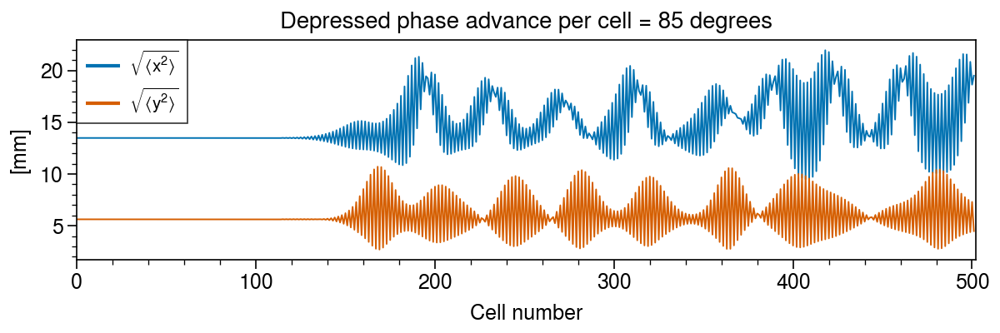

In [7]:
#hide_input
depressed_tunes = np.load('_saved/envelope/depressed_tunes.npy')
sizes_arr = [1e3 * np.load('_saved/envelope/sizes_{}.npy'.format(i)) for i in range(2)]
fig, ax = plot.subplots(figsize=(6, 2))
lw = 0.7
ax.plot(sizes_arr[1][:, 0], lw=lw)
ax.plot(sizes_arr[1][:, 1], lw=lw)
ax.format(xlabel='Cell number', ylabel='[mm]',
          xlim=(0, len(sizes_arr[0])))
ax.legend(labels=[r'$\sqrt{\langle{x^2}\rangle}$', r'$\sqrt{\langle{y^2}\rangle}$'], 
          fontsize='small', ncols=1, loc='upper left', lw=1.5)
ax.set_title(r'Depressed phase advance per cell = {:.0f} degrees'.format(depressed_tunes[1]))
plt.savefig('_saved/env_instability.png', facecolor='white', dpi=300)

The beam is perfectly matched for around 120 cells, after which the mismatch oscillations ensue. It’s important to note that the charge density remains uniform. The phase advances in real linacs are generally kept below 90 deg. to avoid this envelope resonance.

### Higher-order terms 

What about the third-order and fourth-order instabilities? Technically, these just don’t appear in the KV distribution. But simulations always involve a finite number of particles, so there will be small non-uniformities in the beam density. These can grow over time, so the simulated KV distribution is affected by these higher-order instabilities. Setting the zero-current phase advance to 90 deg., a third-order and fourth-order instability should appear at a depressed phase advance of 45 degrees and 30 degrees, respectively, according to the stopband diagram. Here is the evolution of the horizontal phase space in these two cases for an initial KV, Waterbag, and Gaussian beam. (if *H* is an invariant of the motion without space charge, the distribution functions $f$ take the form: $f_{KV}$ ~ $\delta(1 - H)$, $f_{WB}$ ~ $\Theta(1 - H)$, $f_{Gauss}$ ~ $\exp(-H)$, where $\Theta$ is the step function.)

In [8]:
#hide
coords0 = np.load('_saved/mu0-90_mu-45_kv/coords.npy')
coords1 = np.load('_saved/mu0-90_mu-30_kv/coords.npy')
coords2 = np.load('_saved/mu0-90_mu-45_wb/coords.npy')
coords3 = np.load('_saved/mu0-90_mu-30_wb/coords.npy')
coords4 = np.load('_saved/mu0-90_mu-45_gauss/coords.npy')
coords5 = np.load('_saved/mu0-90_mu-30_gauss/coords.npy')

coords_list = [coords0, coords2, coords4, coords1, coords3, coords5]

moments0 = np.load('_saved/mu0-90_mu-45_kv/moments.npy')
moments1 = np.load('_saved/mu0-90_mu-30_kv/moments.npy')
moments2 = np.load('_saved/mu0-90_mu-45_wb/moments.npy')
moments3 = np.load('_saved/mu0-90_mu-30_wb/moments.npy')
moments4 = np.load('_saved/mu0-90_mu-45_gauss/moments.npy')
moments5 = np.load('_saved/mu0-90_mu-30_gauss/moments.npy')

moments_list = [moments0, moments2, moments4, moments1, moments3, moments5]
stats_list = []
for moments in moments_list:
    stats = ba.Stats(1)
    stats.read_moments(moments)
    stats_list.append(stats)

In [9]:
#hide
xmax = max([np.max(coords[:, :, 0]) for coords in coords_list])
xpmax = max([np.max(coords[:, :, 1]) for coords in coords_list])

In [14]:
#hide_input
fig, axes = plot.subplots(nrows=2, ncols=3, figsize=(6, 3.5))
myplt.despine(axes, ('top', 'right'))

axes.format(xlim=(-xmax, xmax), ylim=(-xpmax, xpmax),
            xlabel="x [mm]", ylabel="x' [mrad]",
            suptitle='Horizontal phase space evolution')
for ax, title in zip(axes[0, :], ['KV', 'Waterbag', 'Gaussian']):
    ax.set_title(title)
axes[0, -1].annotate(r'$\nu_{x} = 45\degree$', xy=(1, 0.5), xycoords='axes fraction')
axes[1, -1].annotate(r'$\nu_{x} = 30\degree$', xy=(1, 0.5), xycoords='axes fraction')

kws = dict(lw=0, marker='o', markeredgecolor='none', ms=0.2, c='k')
line0, = axes[0, 0].plot([], [], **kws)
line1, = axes[0, 1].plot([], [], **kws)
line2, = axes[0, 2].plot([], [], **kws)
line3, = axes[1, 0].plot([], [], **kws)
line4, = axes[1, 1].plot([], [], **kws)
line5, = axes[1, 2].plot([], [], **kws)
lines = [line0, line1, line2, line3, line4, line5]
plt.close()

def update(i):
    for ax, line, coords in zip(axes, lines, coords_list):
        X = coords[i]
        line.set_data(X[:, 0], X[:, 1])
    myplt.remove_annotations(axes[0])
    axes[0].annotate('cell {}'.format(i), xy=(0.78, 0.91), xycoords='axes fraction')

frames = len(coords1)
frames = 65
anim = animation.FuncAnimation(fig, update, frames=frames, interval=1000/2)
anim

The order of the resonance is apparent in the symmetry of the phase space distribution (the number of “branches” extending from the core). Here is the emittance growth in each case:

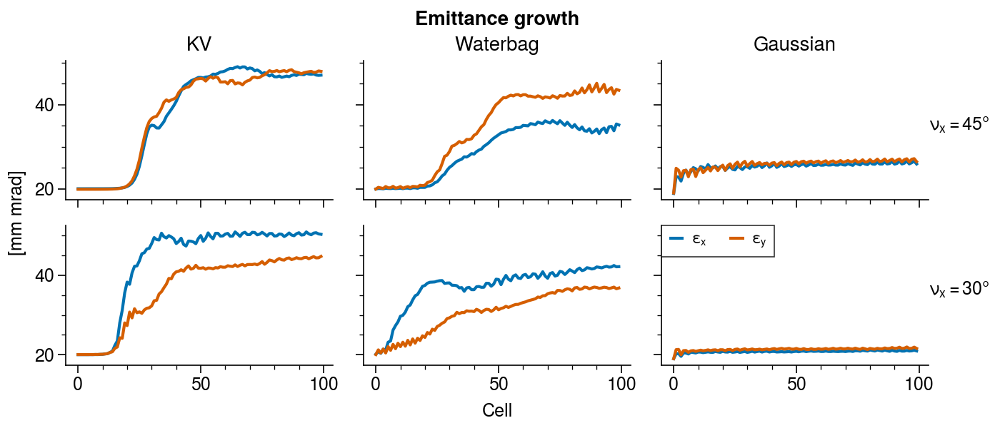

In [11]:
#hide_input
fig, axes = plot.subplots(nrows=2, ncols=3, figsize=(7, 3))
myplt.despine(axes, ('top', 'right'))
axes.format(xlabel="Cell", ylabel="[mm mrad]", suptitle='Emittance growth', grid=True)
for ax, title in zip(axes[0, :], ['KV', 'Waterbag', 'Gaussian']):
    ax.set_title(title)
axes[0, -1].annotate(r'$\nu_{x} = 45\degree$', xy=(1, 0.5), xycoords='axes fraction')
axes[1, -1].annotate(r'$\nu_{x} = 30\degree$', xy=(1, 0.5), xycoords='axes fraction')

for ax, stats in zip(axes, stats_list):
    stats.twiss2D[['ex','ey']].plot(ax=ax, legend=False)
    
axes[1, -1].legend(labels=[r'$\varepsilon_x$', r'$\varepsilon_y$'],
                   ncols=2, handlelength=1, fontsize='small', loc='upper left');

The KV beam is the most violently affected by space charge. This is primarily because there is no tune spread in the KV distribution; thus, any resonance condition is going to affect the entire beam. A Gaussian, on the other hand, has a large tune spread; this tends to “wash out” instabilities because they only affect a fraction of the beam particles. The Waterbag distribution is somewhere in-between. These higher-order KV instabilities are not assumed to be dangerous since real beams are approximately Gaussian due to many other nonlinear processes.

<hr>

{{ 'I’m using the phase advance obtained from the KV envelope equations.' | fndetail: 1 }}